In [ ]:
import pandas as pd

# Load the CSV file
file_path = 'Crowd data for anomaly detection.csv'
df = pd.read_csv(file_path)

# Ensure the timestamp column is in string format (if not already)
df['timestamp'] = df['timestamp'].astype(str)

# Function to convert H:M:S to seconds
def hms_to_seconds(hms):
    h, m, s = map(int, hms.split(':'))
    return h * 3600 + m * 60 + s

# Add a new column for days
df['hours'] = 0

# Initialize the previous timestamp and previous days
previous_timestamp_seconds = hms_to_seconds(df['timestamp'][0])
previous_days = 0

# Iterate through the rows to track days
for index, row in df.iterrows():
    current_timestamp_seconds = hms_to_seconds(row['timestamp'])

    # If the current timestamp is smaller than the previous, it means a new day
    if current_timestamp_seconds < previous_timestamp_seconds:
        previous_days += 1

    # Update the days column
    df.at[index, 'hours'] = previous_days

    previous_timestamp_seconds = current_timestamp_seconds

# Initialize list to store the separate dataframes
dataframes = []
current_df = []

# Iterate through the rows to find the gaps
previous_timestamp_seconds = hms_to_seconds(df['timestamp'][0])
previous_days = df['hours'][0]

for index, row in df.iterrows():
    current_timestamp_seconds = hms_to_seconds(row['timestamp'])
    current_days = row['hours']

    # Check if the difference between the current and previous timestamp is greater than 1 second
    if current_days == previous_days and current_timestamp_seconds - previous_timestamp_seconds > 1:
        # If there is a gap, save the current dataframe and start a new one
        dataframes.append(pd.DataFrame(current_df))
        current_df = [row]
    else:
        current_df.append(row)

    previous_timestamp_seconds = current_timestamp_seconds
    previous_days = current_days

# Don't forget to add the last dataframe
if current_df:
    dataframes.append(pd.DataFrame(current_df))

# Combine all dataframes into a single dataframe
combined_df = pd.concat(dataframes, ignore_index=True)

# Save the combined dataframe to a CSV file
combined_df.to_csv('combined_data.csv', index=False)

print('Successfully saved combined data to "combined_data.csv".')

Successfully saved combined data to "combined_data.csv".


In [ ]:
import pandas as pd

# Load the CSV file into a DataFrame
df = pd.read_csv('Update Crowd data for anomaly detection.csv')

# Function to add hours to the timestamp
def add_hours_to_timestamp(row):
    time_parts = list(map(int, row['timestamp'].split(':')))
    time_parts[0] += row['hours']
    return f"{time_parts[0]:02d}:{time_parts[1]:02d}:{time_parts[2]:02d}"

# Apply the function to each row
df['timestamp'] = df.apply(add_hours_to_timestamp, axis=1)

# Drop the hours column
df = df.drop(columns=['hours'])

# Save the updated DataFrame to a new CSV file
df.to_csv('output.csv', index=False)

##Visualizing Anomalies with different features over timestamp

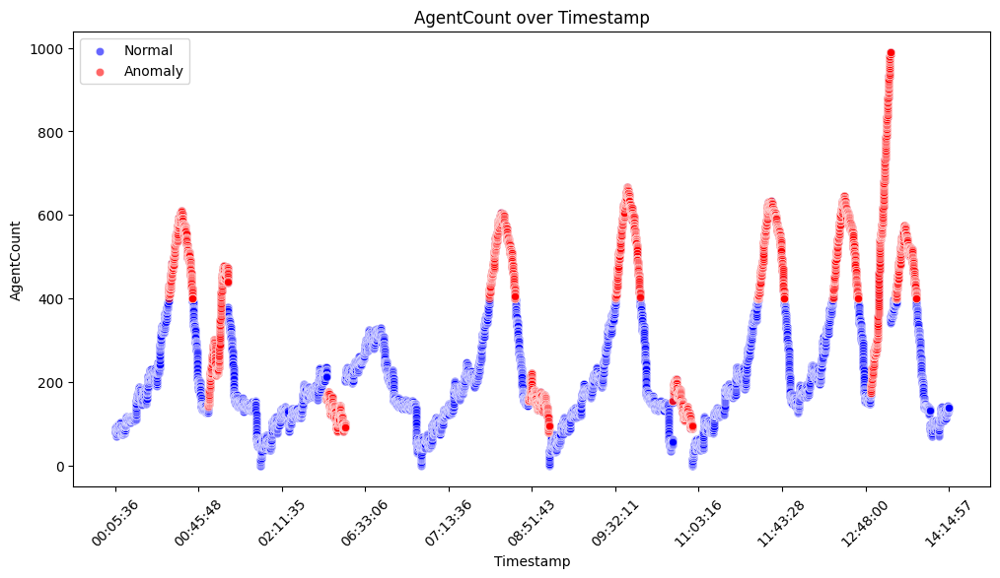

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load the dataset
file_path = 'Update Crowd data for anomaly detection.csv'
data = pd.read_csv(file_path)

# Plotting AgentCount over timestamp with anomaly points marked in red
plt.figure(figsize=(12, 6))
sns.scatterplot(x=data['timestamp'], y=data['AgentCount'], color='blue', alpha=0.6, label='Normal')

# Highlight anomaly points in red
anomaly_data = data[data['label'] == 1]
sns.scatterplot(x=anomaly_data['timestamp'], y=anomaly_data['AgentCount'], color='red', alpha=0.6, label='Anomaly')

# Format the x-axis to make it more readable
plt.title('AgentCount over Timestamp')
plt.xlabel('Timestamp')
plt.ylabel('AgentCount')
plt.xticks(rotation=45)

# Customize x-ticks
tick_interval = len(data) // 10  # Adjust this interval based on the number of data points
plt.xticks(data['timestamp'][::tick_interval])

plt.legend()
plt.show()

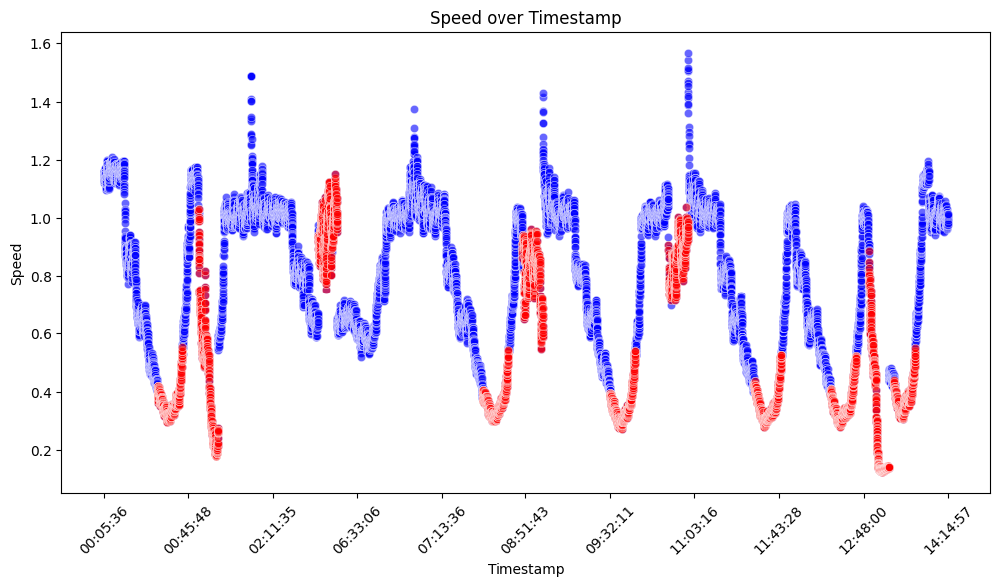

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load the dataset
file_path = 'Update Crowd data for anomaly detection.csv'
data = pd.read_csv(file_path)

# Plotting Speed over timestamp with anomaly points marked in red
plt.figure(figsize=(12, 6))
sns.scatterplot(x=data['timestamp'], y=data['Speed'], color='blue', alpha=0.6)

# Highlight anomaly points in red
anomaly_data = data[data['label'] == 1]
sns.scatterplot(x=anomaly_data['timestamp'], y=anomaly_data['Speed'], color='red', alpha=0.6)

# Format the x-axis to make it more readable
plt.title('Speed over Timestamp')
plt.xlabel('Timestamp')
plt.ylabel('Speed')
plt.xticks(rotation=45)

# Customize x-ticks
tick_interval = len(data) // 10  # Adjust this interval based on the number of data points
plt.xticks(data['timestamp'][::tick_interval])

plt.show()

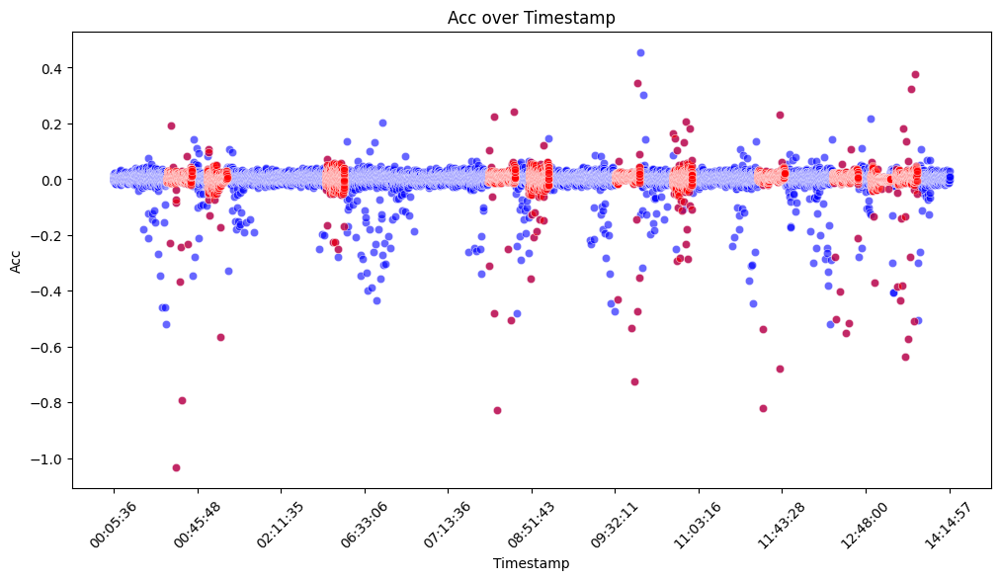

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load the dataset
file_path = 'Update Crowd data for anomaly detection.csv'
data = pd.read_csv(file_path)

# Plotting Acc over timestamp with anomaly points marked in red
plt.figure(figsize=(12, 6))
sns.scatterplot(x=data['timestamp'], y=data['Acc'], color='blue', alpha=0.6)

# Highlight anomaly points in red
anomaly_data = data[data['label'] == 1]
sns.scatterplot(x=anomaly_data['timestamp'], y=anomaly_data['Acc'], color='red', alpha=0.6)

# Format the x-axis to make it more readable
plt.title('Acc over Timestamp')
plt.xlabel('Timestamp')
plt.ylabel('Acc')
plt.xticks(rotation=45)

# Customize x-ticks
tick_interval = len(data) // 10  # Adjust this interval based on the number of data points
plt.xticks(data['timestamp'][::tick_interval])

plt.show()

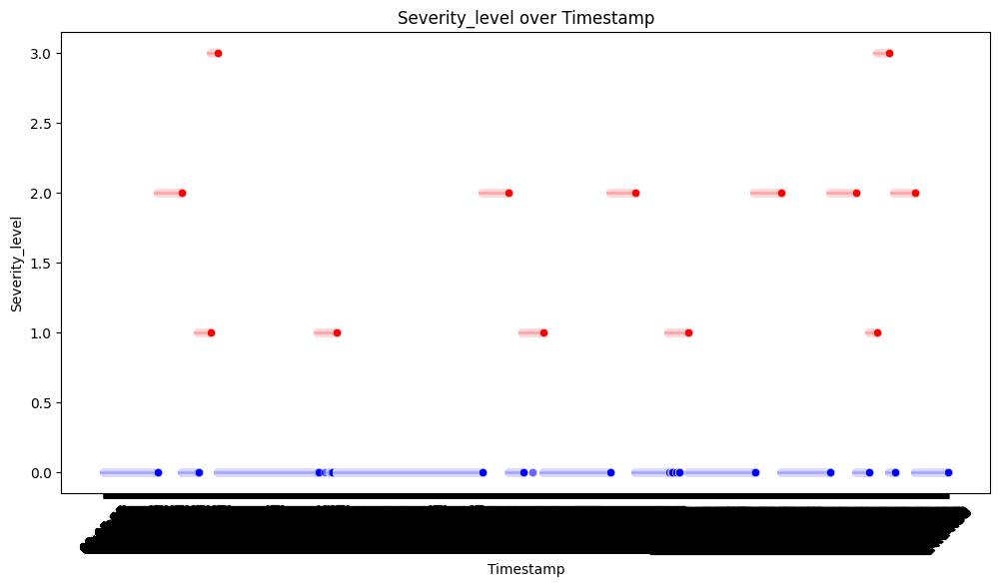

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load the dataset
file_path = 'Update Crowd data for anomaly detection.csv'
data = pd.read_csv(file_path)

# Plotting Speed over timestamp with anomaly points marked in red
plt.figure(figsize=(12, 6))
sns.scatterplot(x=data['timestamp'], y=data['Severity_level'], color='blue', alpha=0.6)

# Highlight anomaly points in red
anomaly_data = data[data['label'] == 1]
sns.scatterplot(x=anomaly_data['timestamp'], y=anomaly_data['Severity_level'], color='red', alpha=0.6)

plt.title('Severity_level over Timestamp')
plt.xlabel('Timestamp')
plt.ylabel('Severity_level')
plt.xticks(rotation=45)
plt.show()

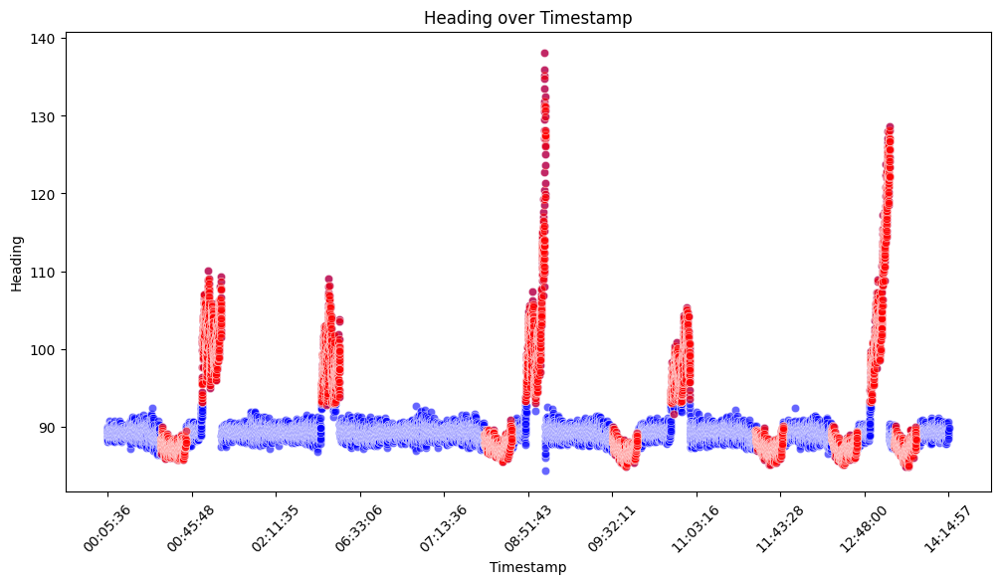

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load the dataset
file_path = 'Update Crowd data for anomaly detection.csv'
data = pd.read_csv(file_path)

# Plotting Heading over timestamp with anomaly points marked in red
plt.figure(figsize=(12, 6))
sns.scatterplot(x=data['timestamp'], y=data['Heading'], color='blue', alpha=0.6)

# Highlight anomaly points in red
anomaly_data = data[data['label'] == 1]
sns.scatterplot(x=anomaly_data['timestamp'], y=anomaly_data['Heading'], color='red', alpha=0.6)

# Format the x-axis to make it more readable
plt.title('Heading over Timestamp')
plt.xlabel('Timestamp')
plt.ylabel('Heading')
plt.xticks(rotation=45)

# Customize x-ticks
tick_interval = len(data) // 10  # Adjust this interval based on the number of data points
plt.xticks(data['timestamp'][::tick_interval])

plt.show()

##Anomaly Detection in Crowd Data Using Decision Tree Classifier

Confusion Matrix:
[[5121    1]
 [   1 2083]]

Classification Report:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00      5122
           1       1.00      1.00      1.00      2084

    accuracy                           1.00      7206
   macro avg       1.00      1.00      1.00      7206
weighted avg       1.00      1.00      1.00      7206



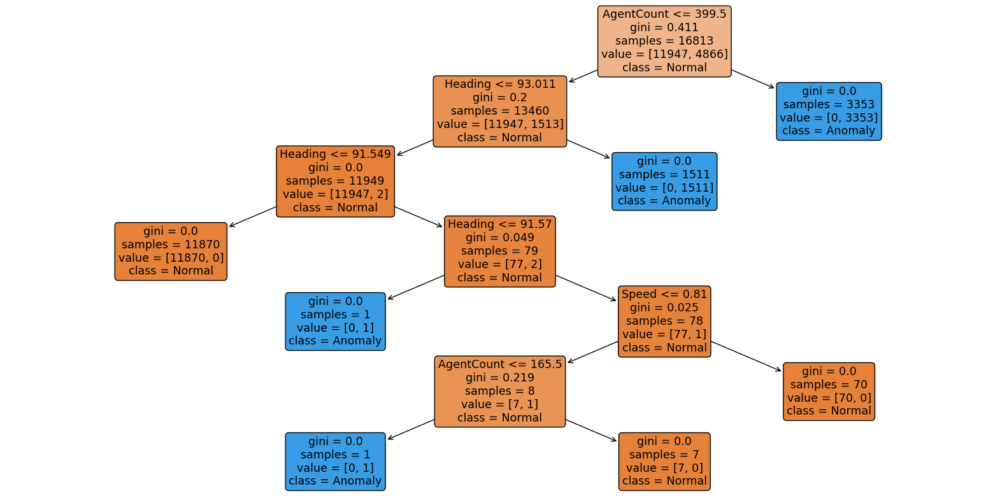

In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.tree import plot_tree
import matplotlib.pyplot as plt

# Load the dataset
file_path = 'Copy of Update Crowd data for anomaly detection.csv'
data = pd.read_csv(file_path)

# Define features and target variable
features = data.drop(columns=['Label'])  # Drop the Label column to use the rest as features
target = data['Label']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(features, target, test_size=0.3, random_state=42)

# Train the decision tree model
clf = DecisionTreeClassifier(random_state=42)
clf.fit(X_train, y_train)

# Evaluate the model
y_pred = clf.predict(X_test)
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred))
print("\nClassification Report:")
print(classification_report(y_test, y_pred))

# Visualize the decision tree
plt.figure(figsize=(20,10))
plot_tree(clf, filled=True, feature_names=features.columns, class_names=['Normal', 'Anomaly'], rounded=True)
plt.show()

##Mapping Density Values to Levels of Crowdness from CSV Data

In [ ]:
import pandas as pd
from collections import defaultdict

# Load the CSV file into a DataFrame
df = pd.read_csv('/content/Crowd data for anomaly detection.csv')

# Initialize a dictionary to hold LevelOfCrowdness as keys and sets of Density as values
crowdness_dict = defaultdict(set)

# Iterate over the DataFrame and populate the dictionary
for _, row in df.iterrows():
    level_of_crowdness = row['LevelOfCrowdness']
    density = row['Density']
    crowdness_dict[level_of_crowdness].add(density)

# Convert sets to sorted lists
sorted_crowdness_dict = {k: sorted(v) for k, v in crowdness_dict.items()}

print(sorted_crowdness_dict)

{1: [0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08, 0.09, 0.1, 0.11, 0.12, 0.13, 0.14, 0.15, 0.16, 0.17, 0.18, 0.19, 0.2, 0.21, 0.22, 0.23, 0.24, 0.25, 0.26, 0.27, 0.28, 0.29, 0.3, 0.31, 0.32, 0.33, 0.34, 0.35, 0.36, 0.37, 0.38, 0.39, 0.4, 0.41, 0.42, 0.43, 0.44, 0.45, 0.46, 0.47, 0.48, 0.49, 0.5, 0.51, 0.52, 0.53, 0.54, 0.55, 0.56, 0.57, 0.58, 0.59, 0.6, 0.61, 0.62, 0.63, 0.64, 0.65, 0.66, 0.67, 0.68, 0.69, 0.7, 0.71, 0.72, 0.73, 0.74, 0.75, 0.76, 0.77, 0.78, 0.79, 0.8, 0.81, 0.82, 0.83, 0.84, 0.85, 0.86, 0.87, 0.88, 0.89, 0.9, 0.91, 0.92, 0.93, 0.94, 0.95, 0.96, 0.97, 0.98, 0.99, 1.0, 1.01, 1.02, 1.03, 1.04, 1.05, 1.06, 1.07, 1.08, 1.09, 1.1, 1.11, 1.12, 1.13, 1.14, 1.15, 1.16, 1.17, 1.18, 1.19, 1.2, 1.21, 1.22, 1.23, 1.24, 1.25, 1.26, 1.27, 1.28, 1.29, 1.3, 1.31, 1.32, 1.33, 1.34, 1.35, 1.36, 1.37, 1.38, 1.39, 1.4, 1.41, 1.42, 1.43, 1.44, 1.45, 1.46, 1.47, 1.48, 1.49, 1.5, 1.51, 1.52, 1.53, 1.54, 1.55, 1.56, 1.57, 1.58, 1.59, 1.6, 1.61, 1.62, 1.63, 1.64, 1.65, 1.66, 1.67, 1.68, 1.6

In [ ]:
for i in sorted_crowdness_dict:
  print(str(i) + " " + str(sorted_crowdness_dict[i]) )

1 [0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08, 0.09, 0.1, 0.11, 0.12, 0.13, 0.14, 0.15, 0.16, 0.17, 0.18, 0.19, 0.2, 0.21, 0.22, 0.23, 0.24, 0.25, 0.26, 0.27, 0.28, 0.29, 0.3, 0.31, 0.32, 0.33, 0.34, 0.35, 0.36, 0.37, 0.38, 0.39, 0.4, 0.41, 0.42, 0.43, 0.44, 0.45, 0.46, 0.47, 0.48, 0.49, 0.5, 0.51, 0.52, 0.53, 0.54, 0.55, 0.56, 0.57, 0.58, 0.59, 0.6, 0.61, 0.62, 0.63, 0.64, 0.65, 0.66, 0.67, 0.68, 0.69, 0.7, 0.71, 0.72, 0.73, 0.74, 0.75, 0.76, 0.77, 0.78, 0.79, 0.8, 0.81, 0.82, 0.83, 0.84, 0.85, 0.86, 0.87, 0.88, 0.89, 0.9, 0.91, 0.92, 0.93, 0.94, 0.95, 0.96, 0.97, 0.98, 0.99, 1.0, 1.01, 1.02, 1.03, 1.04, 1.05, 1.06, 1.07, 1.08, 1.09, 1.1, 1.11, 1.12, 1.13, 1.14, 1.15, 1.16, 1.17, 1.18, 1.19, 1.2, 1.21, 1.22, 1.23, 1.24, 1.25, 1.26, 1.27, 1.28, 1.29, 1.3, 1.31, 1.32, 1.33, 1.34, 1.35, 1.36, 1.37, 1.38, 1.39, 1.4, 1.41, 1.42, 1.43, 1.44, 1.45, 1.46, 1.47, 1.48, 1.49, 1.5, 1.51, 1.52, 1.53, 1.54, 1.55, 1.56, 1.57, 1.58, 1.59, 1.6, 1.61, 1.62, 1.63, 1.64, 1.65, 1.66, 1.67, 1.68, 1.69,

In [ ]:
import pandas as pd

# Function to convert time strings to seconds for easier comparison
def time_to_seconds(time_str):
    h, m, s = map(int, time_str.split(':'))
    return h * 3600 + m * 60 + s

# Load the CSV file into a DataFrame
file_path = '/content/Crowd data for anomaly detection.csv'
data = pd.read_csv(file_path)

# Initialize variables
previous_time = None
break_indices = []

# Find break points
for i, row in data.iterrows():
    current_time = time_to_seconds(row['timestamp'])
    if previous_time is not None and current_time != previous_time + 1:
        break_indices.append(i)
    previous_time = current_time

# Function to save DataFrame chunks to CSV
def save_chunk_to_csv(data, start_idx, end_idx, chunk_num):
    chunk = data.iloc[start_idx:end_idx]
    chunk.to_csv(f'output_chunk_{chunk_num}.csv', index=False)

# Save each chunk to a new CSV file
start_idx = 0
for chunk_num, break_idx in enumerate(break_indices, start=1):
    save_chunk_to_csv(data, start_idx, break_idx, chunk_num)
    start_idx = break_idx

# Save the last chunk
save_chunk_to_csv(data, start_idx, len(data), len(break_indices) + 1)

print(f"CSV file has been split into {len(break_indices) + 1} files.")

CSV file has been split into 18 files.


##Approach 2 (Multiple Devices)

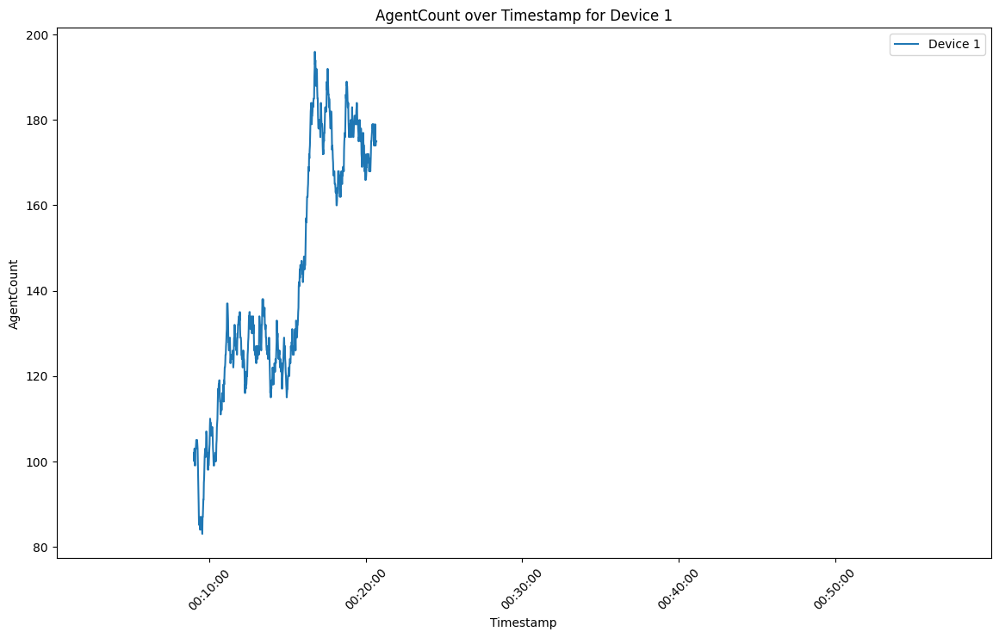

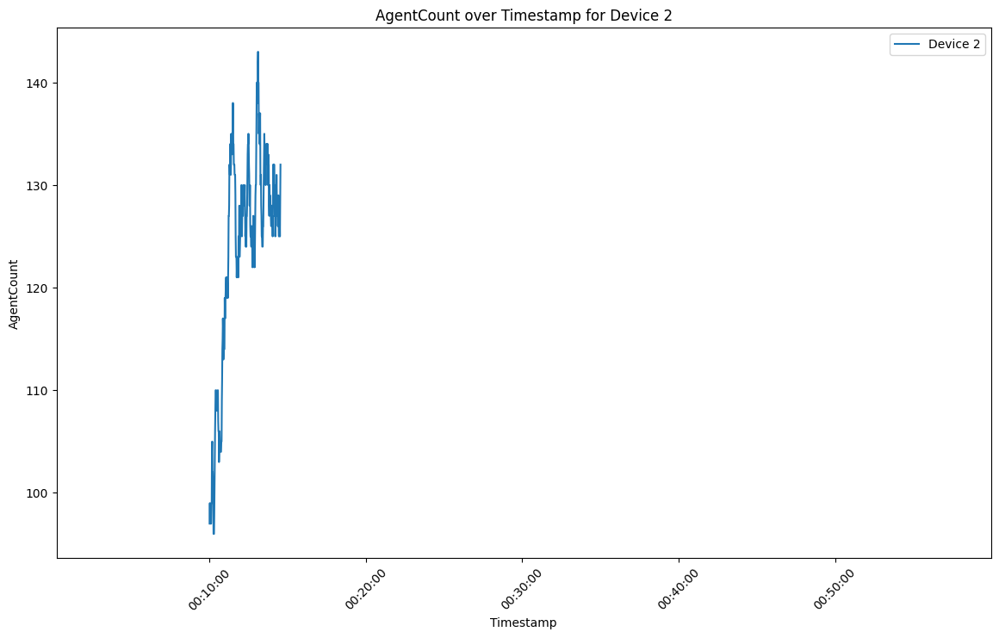

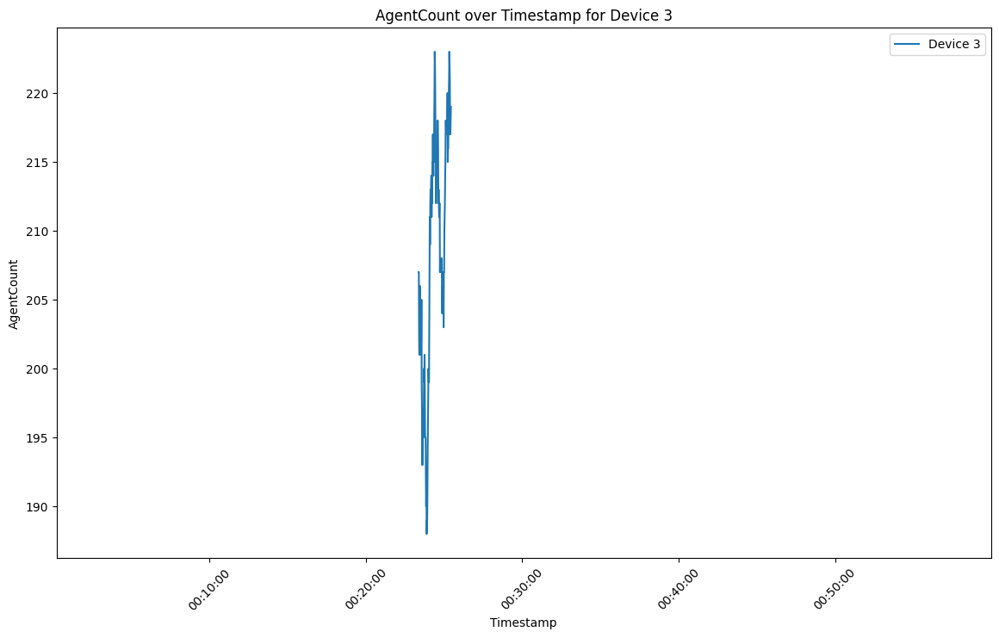

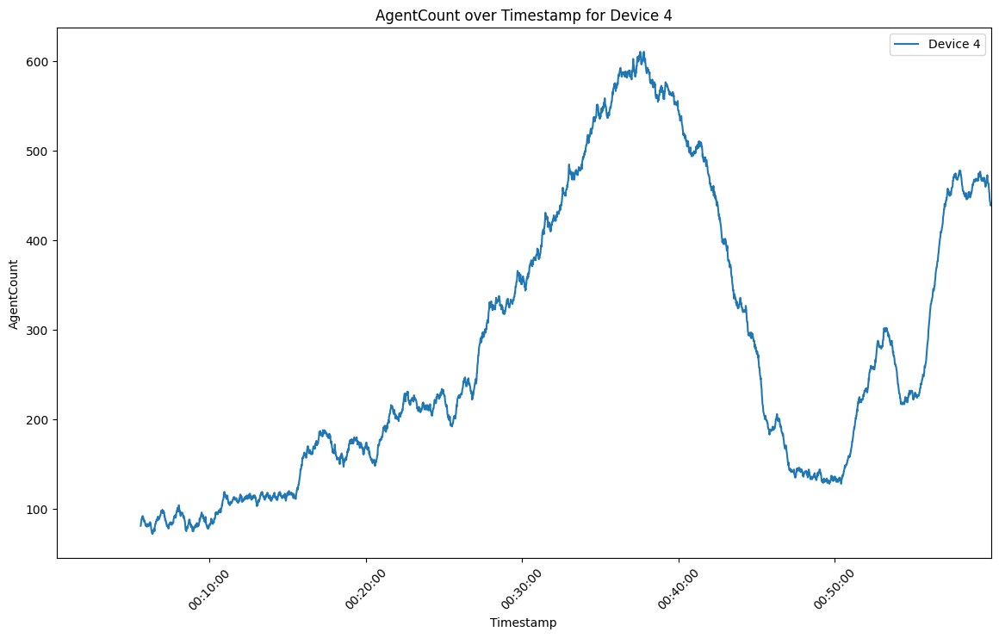

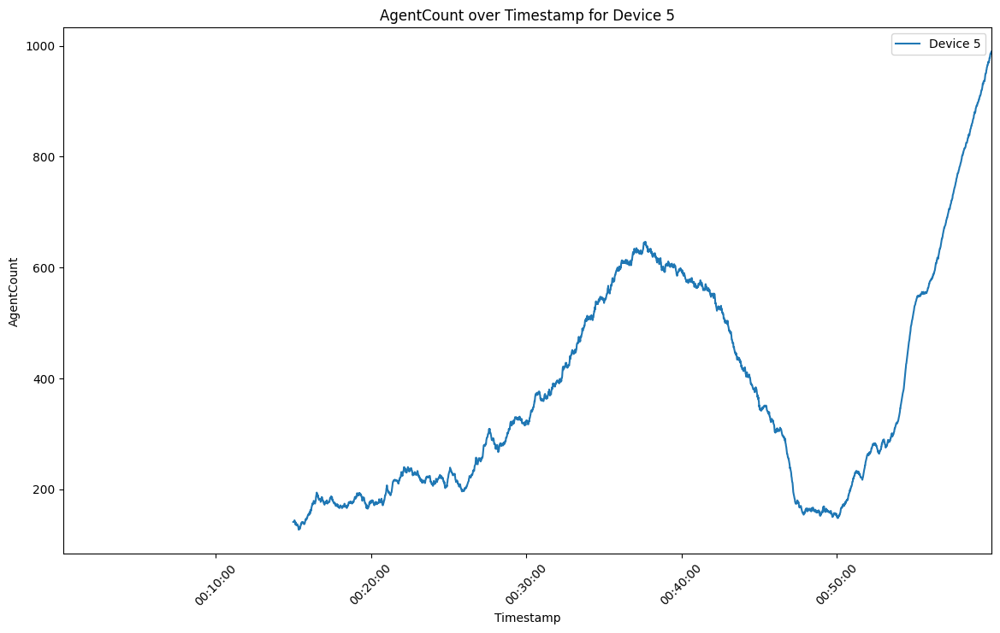

...

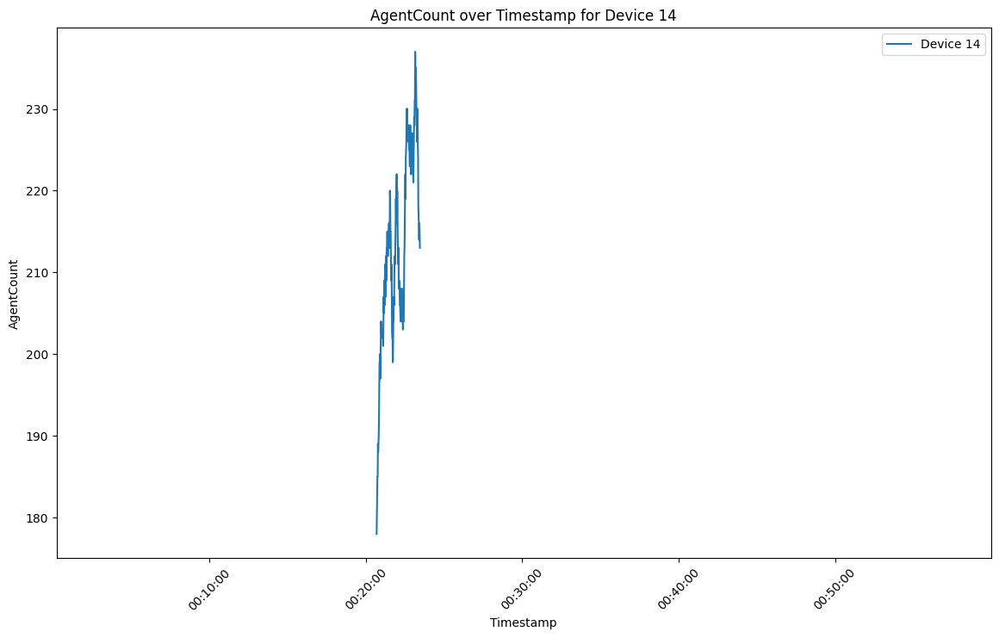

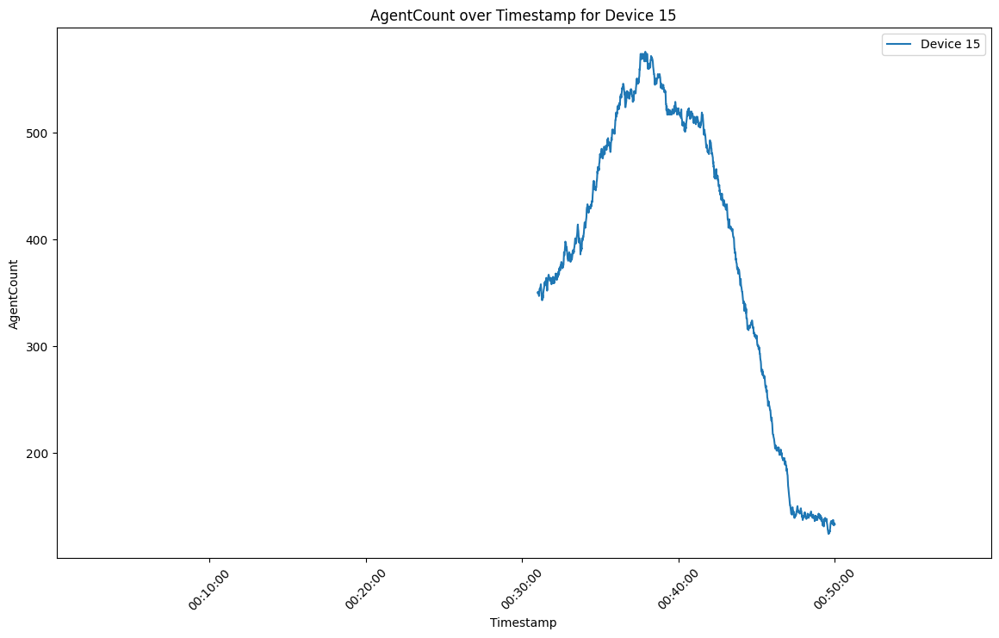

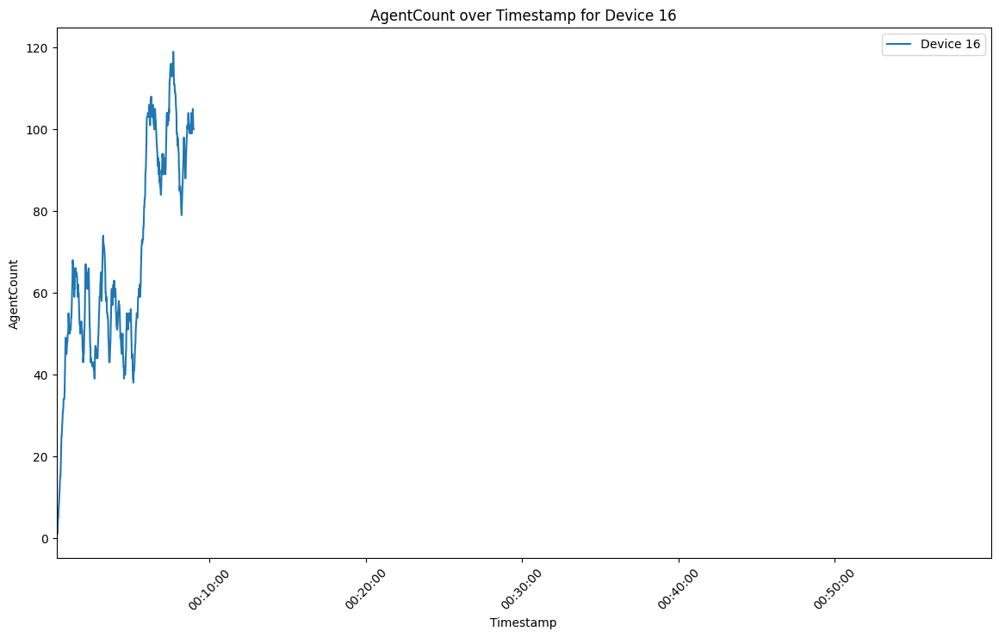

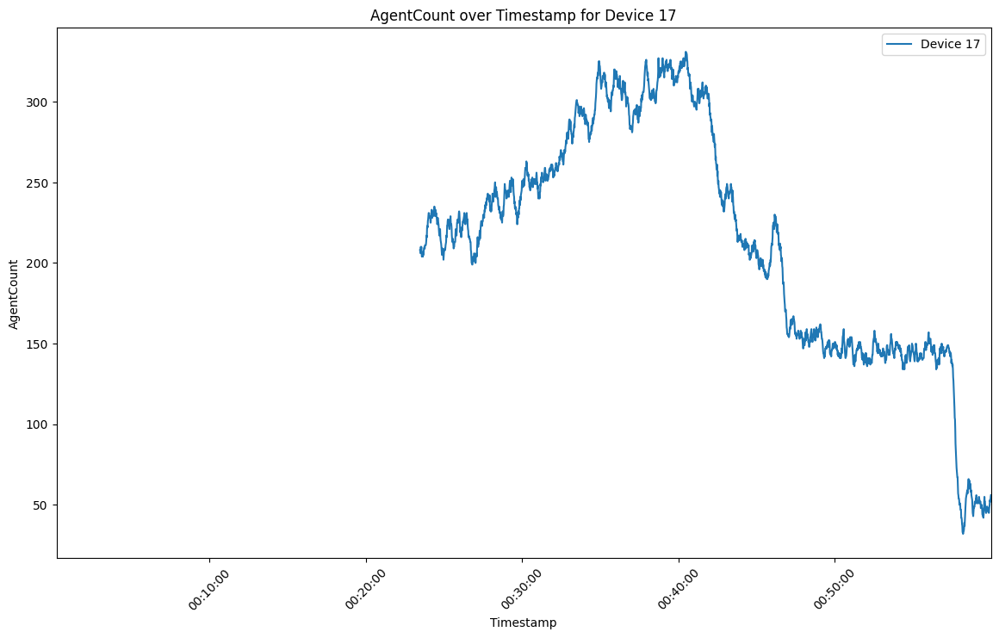

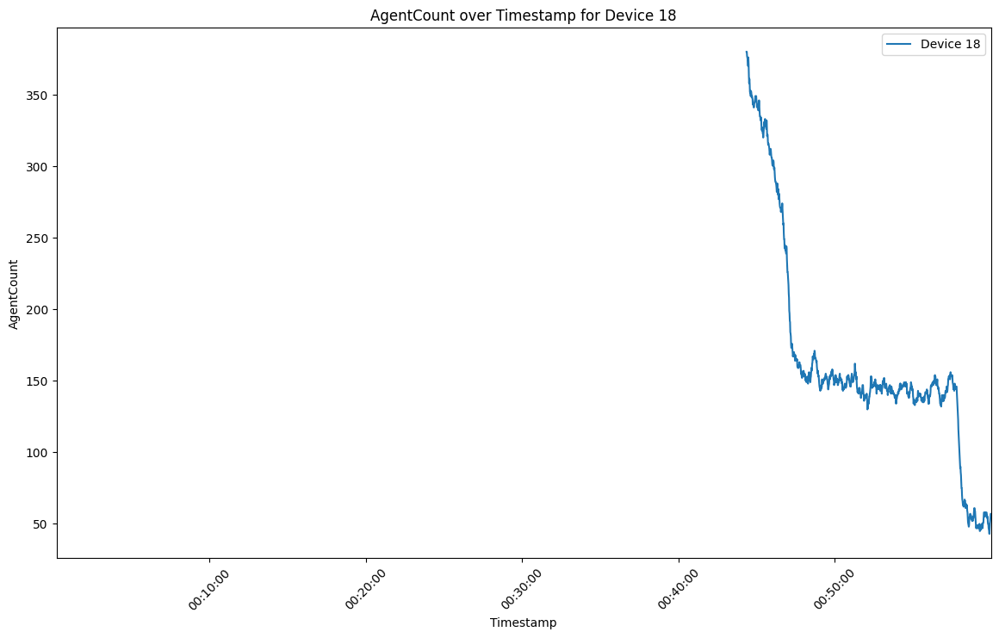

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import glob

# Assuming all your CSV files are in the same directory and follow a pattern like 'output_chunk_1.csv', 'output_chunk_2.csv', etc.
file_pattern = 'output_chunk_*.csv'

# Get a list of all matching files
csv_files = glob.glob(file_pattern)

# Initialize variables to find the global range of timestamps
global_min_timestamp = None
global_max_timestamp = None

# Loop through each CSV file to find the global min and max timestamps
for file in csv_files:
    data = pd.read_csv(file)
    if 'timestamp' in data.columns:
        # Specify the timestamp format
        data['timestamp'] = pd.to_datetime(data['timestamp'], format='%H:%M:%S')
        min_timestamp = data['timestamp'].min()
        max_timestamp = data['timestamp'].max()
        if global_min_timestamp is None or min_timestamp < global_min_timestamp:
            global_min_timestamp = min_timestamp
        if global_max_timestamp is None or max_timestamp > global_max_timestamp:
            global_max_timestamp = max_timestamp

# Loop through each CSV file and create a plot for each one
for i, file in enumerate(csv_files):
    data = pd.read_csv(file)

    # Check if the necessary columns are present
    if 'timestamp' in data.columns and 'AgentCount' in data.columns:
        # Specify the timestamp format
        data['timestamp'] = pd.to_datetime(data['timestamp'], format='%H:%M:%S')
        # Ensure timestamps are sorted
        data = data.sort_values('timestamp')

        # Create a new figure for each plot
        plt.figure(figsize=(14, 8))

        # Plot the AgentCount over timestamp
        plt.plot(data['timestamp'], data['AgentCount'], label=f'Device {i+1}')

        # Adding labels and title
        plt.xlabel('Timestamp')
        plt.ylabel('AgentCount')
        plt.title(f'AgentCount over Timestamp for Device {i+1}')
        plt.xticks(rotation=45)
        plt.legend(loc='upper right')

        # Set the x-axis limits to the global timestamp range
        plt.xlim(global_min_timestamp, global_max_timestamp)

        # Format the x-axis to show the timestamps correctly
        plt.gca().xaxis.set_major_formatter(plt.matplotlib.dates.DateFormatter('%H:%M:%S'))

        # Show the plot
        plt.show()

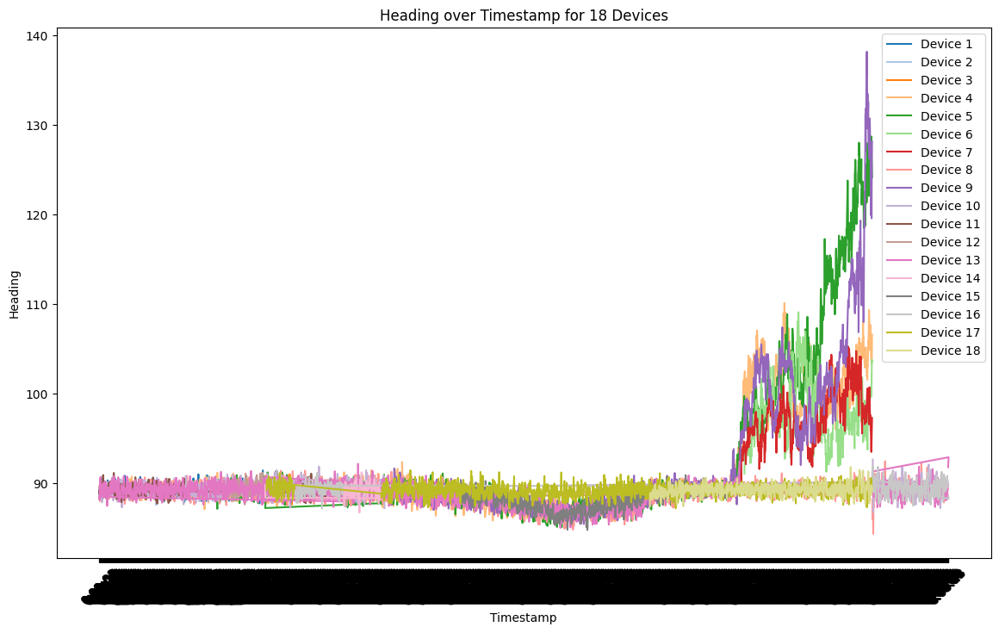

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import glob

# Assuming all your CSV files are in the same directory and follow a pattern like 'output_chunk_1.csv', 'output_chunk_2.csv', etc.
file_pattern = 'output_chunk_*.csv'

# Get a list of all matching files
csv_files = glob.glob(file_pattern)

# Create a color map for different lines
colors = plt.colormaps['tab20'](range(len(csv_files)))

# Initialize the plot
plt.figure(figsize=(14, 8))

# Loop through each CSV file
for i, file in enumerate(csv_files):
    # Load the CSV file into a DataFrame
    data = pd.read_csv(file)

    # Check if the necessary columns are present
    if 'timestamp' in data.columns and 'Heading' in data.columns:
        # Ensure timestamps are sorted
        data = data.sort_values('timestamp')
        # Plot the AgentCount over timestamp
        plt.plot(data['timestamp'], data['Heading'], label=f'Device {i+1}', color=colors[i])

# Adding labels and title
plt.xlabel('Timestamp')
plt.ylabel('Heading')
plt.title('Heading over Timestamp for 18 Devices')
plt.xticks(rotation=45)
plt.legend(loc='upper right')

# Show the plot
plt.show()

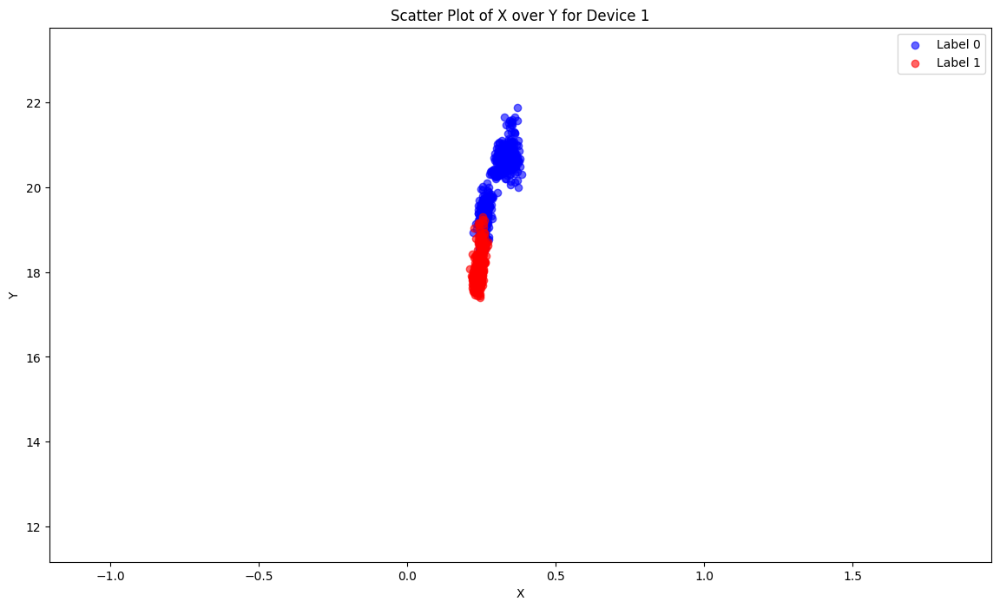

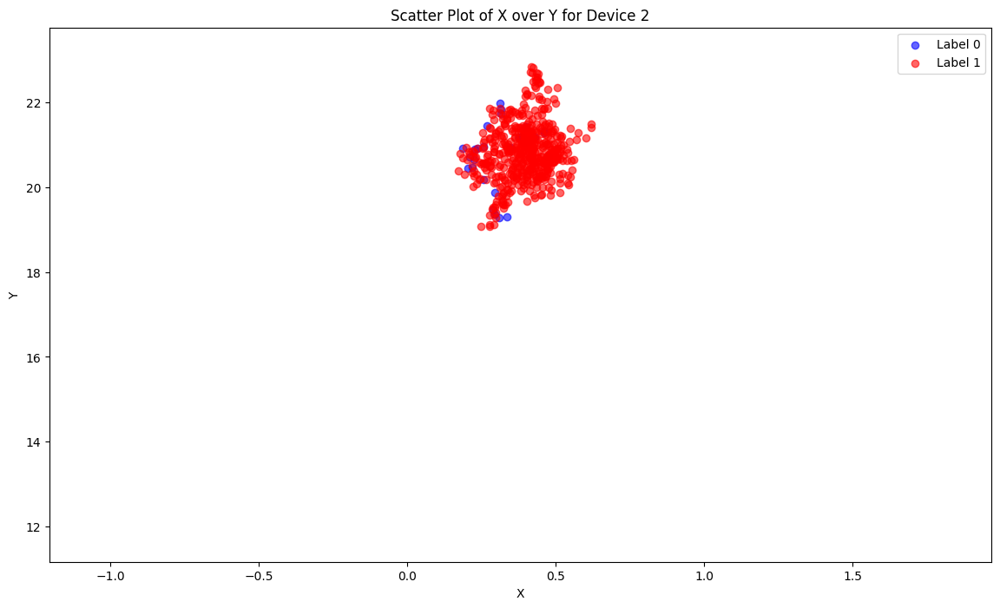

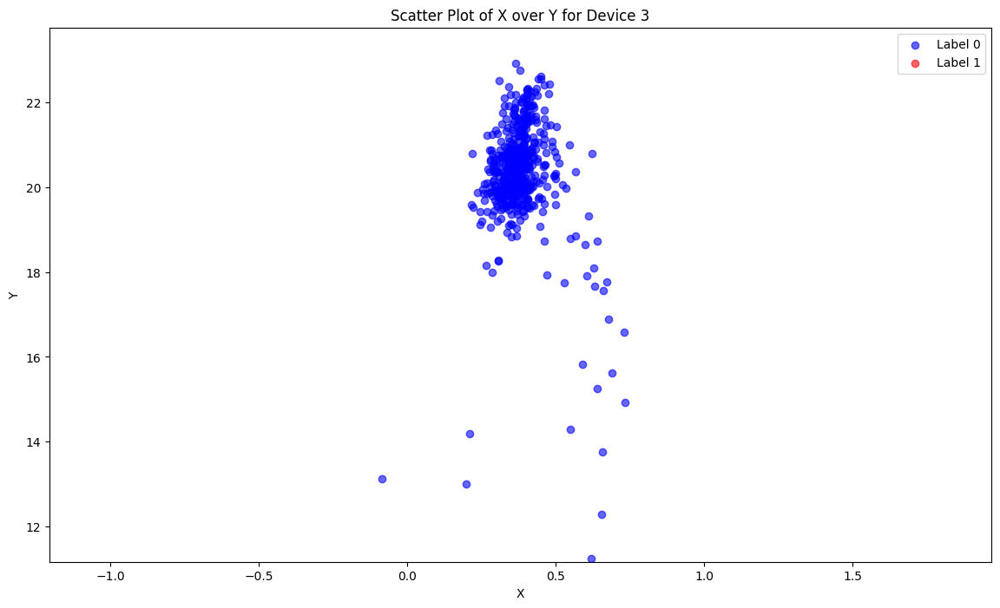

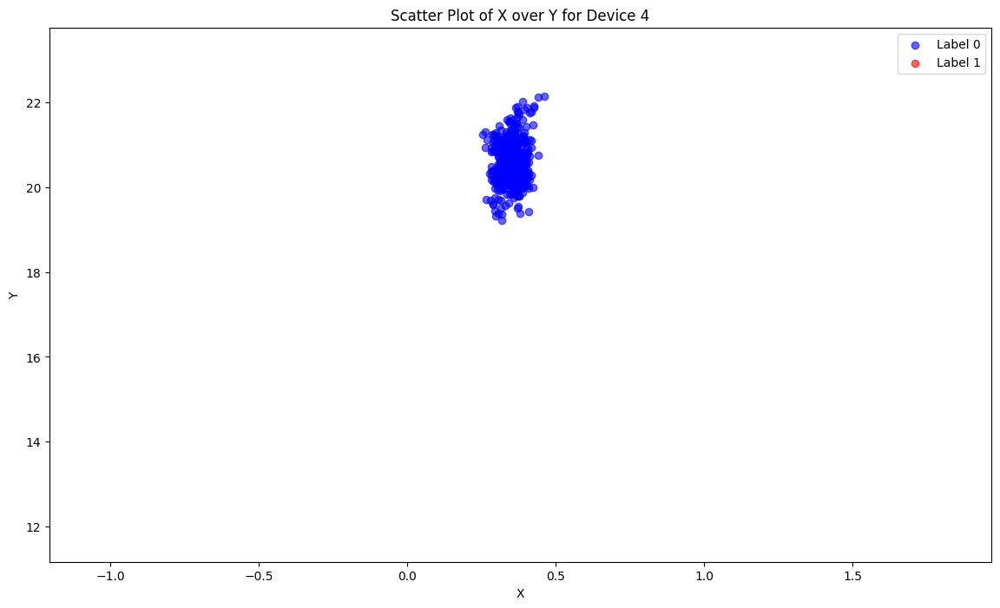

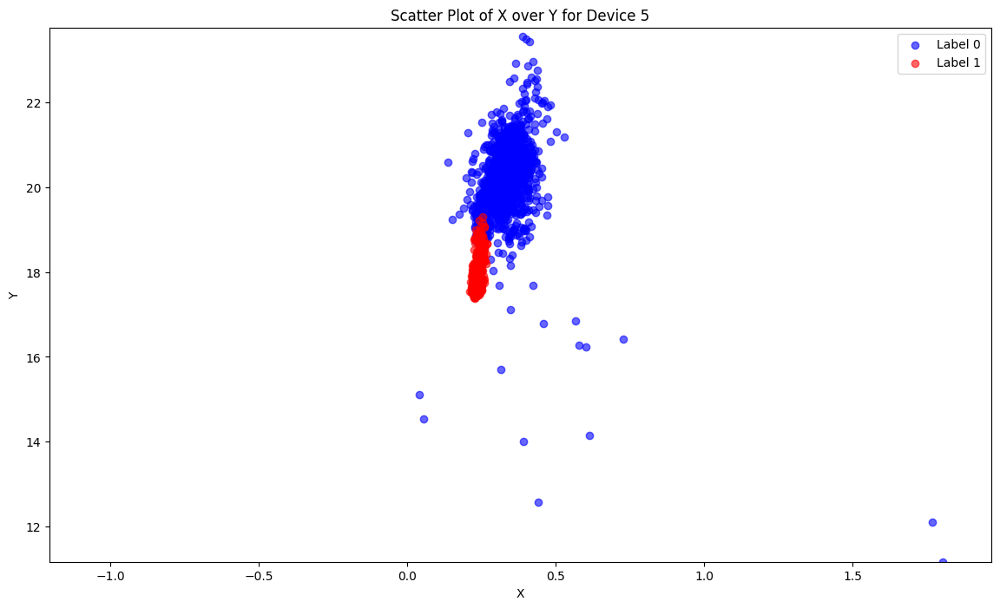

...

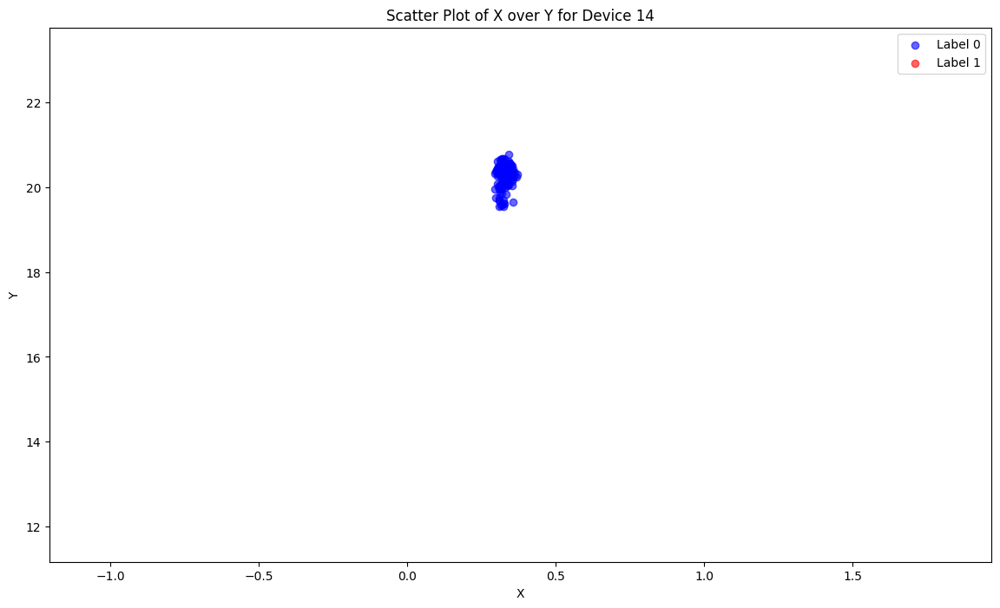

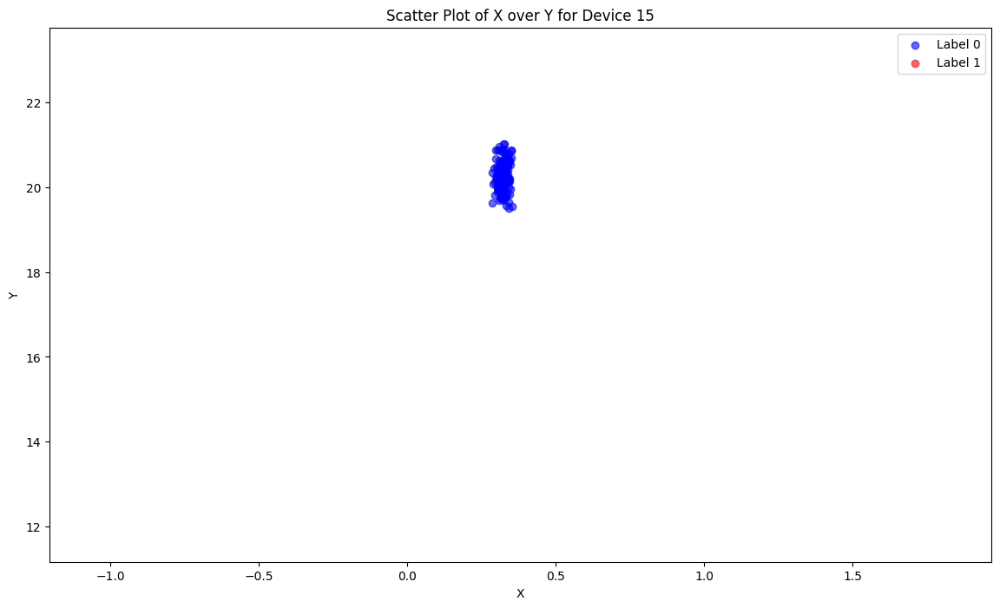

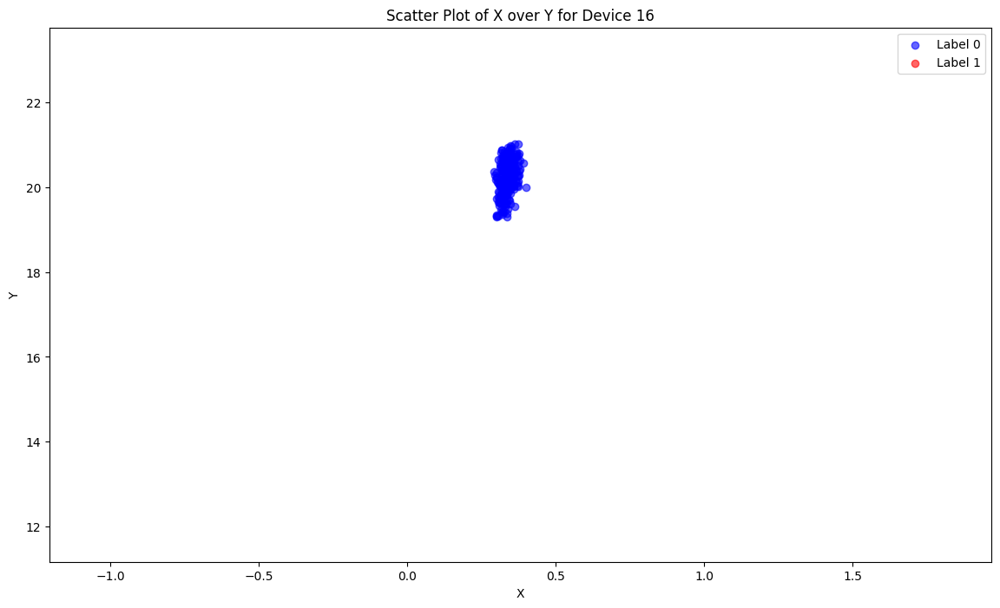

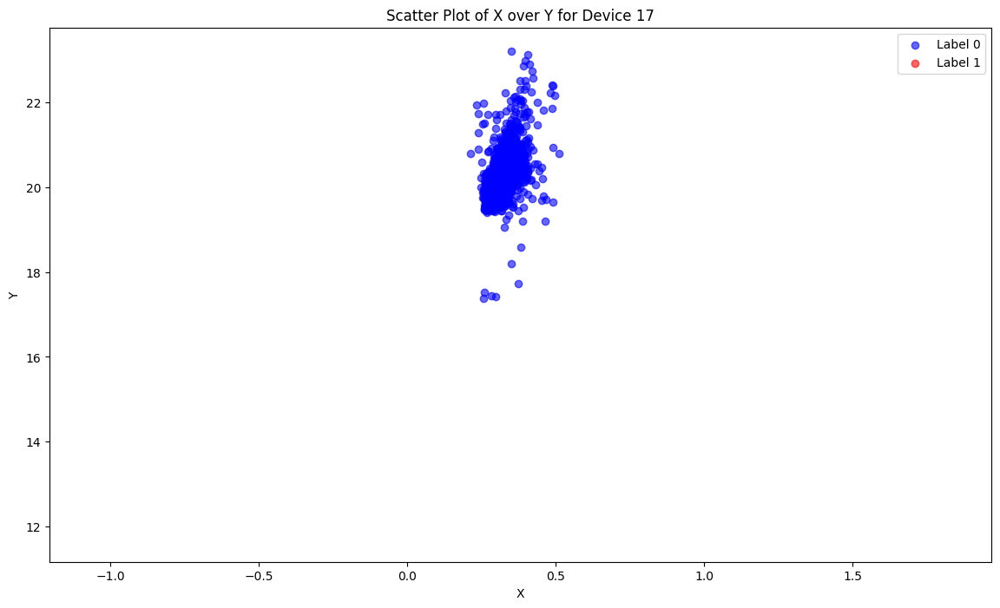

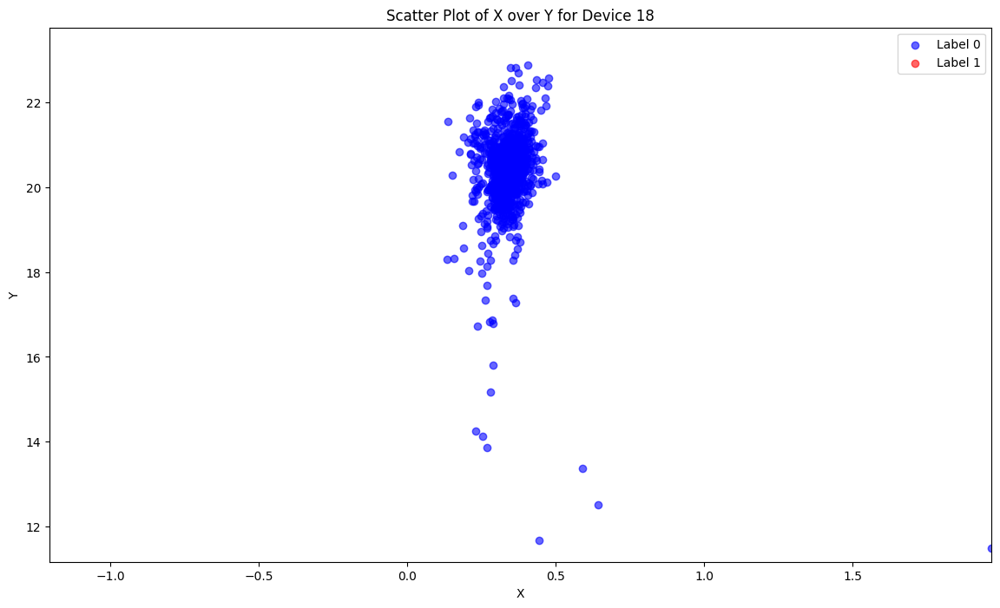

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import glob

# Assuming all your CSV files are in the same directory and follow a pattern like 'output_chunk_1.csv', 'output_chunk_2.csv', etc.
file_pattern = 'output_chunk_*.csv'

# Get a list of all matching files
csv_files = glob.glob(file_pattern)

# Initialize variables to find the global range of X and Y
global_min_x, global_max_x = float('inf'), float('-inf')
global_min_y, global_max_y = float('inf'), float('-inf')

# Loop through each CSV file to find the global min and max for X and Y
for file in csv_files:
    data = pd.read_csv(file)
    if 'X' in data.columns and 'Y' in data.columns:
        min_x, max_x = data['X'].min(), data['X'].max()
        min_y, max_y = data['Y'].min(), data['Y'].max()
        global_min_x = min(global_min_x, min_x)
        global_max_x = max(global_max_x, max_x)
        global_min_y = min(global_min_y, min_y)
        global_max_y = max(global_max_y, max_y)

# Loop through each CSV file and create a scatter plot for each one
for i, file in enumerate(csv_files):
    data = pd.read_csv(file)

    # Check if the necessary columns are present
    if 'X' in data.columns and 'Y' in data.columns and 'label' in data.columns:
        # Create a new figure for each plot
        plt.figure(figsize=(14, 8))

        # Plot the points, coloring based on the label
        plt.scatter(data[data['label'] == 0]['X'], data[data['label'] == 0]['Y'], color='blue', label='Label 0', alpha=0.6)
        plt.scatter(data[data['label'] == 1]['X'], data[data['label'] == 1]['Y'], color='red', label='Label 1', alpha=0.6)

        # Adding labels and title
        plt.xlabel('X')
        plt.ylabel('Y')
        plt.title(f'Scatter Plot of X over Y for Device {i+1}')
        plt.legend(loc='upper right')

        # Set the x and y axis limits to the global range
        plt.xlim(global_min_x, global_max_x)
        plt.ylim(global_min_y, global_max_y)

        # Show the plot
        plt.show()

##Video on Aerial view of the data

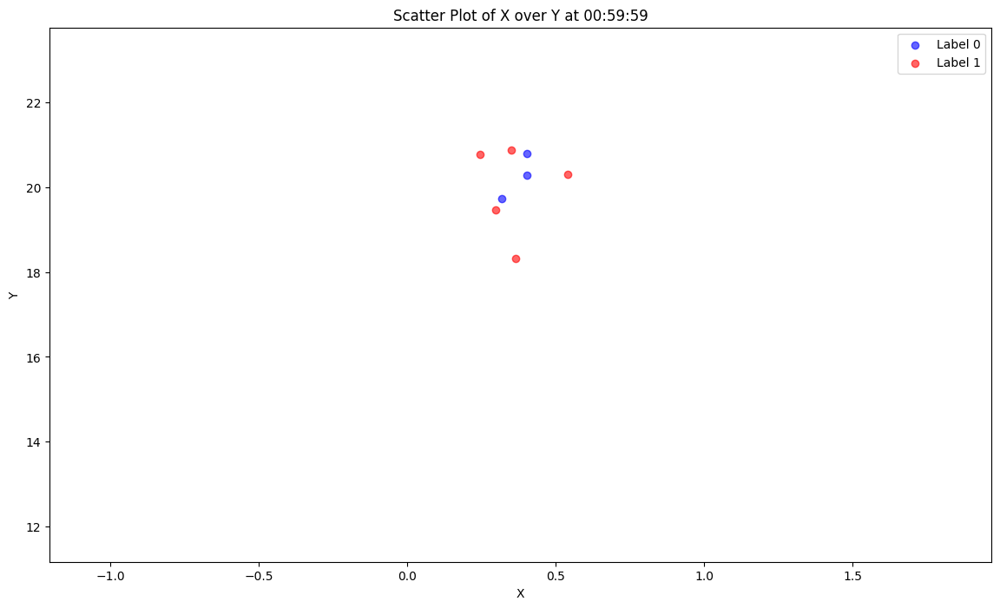

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import glob
import matplotlib.animation as animation
from IPython.display import HTML

# Assuming all your CSV files are in the same directory and follow a pattern like 'output_chunk_1.csv', 'output_chunk_2.csv', etc.
file_pattern = 'output_chunk_*.csv'

# Get a list of all matching files
csv_files = glob.glob(file_pattern)

# Initialize variables to find the global range of X and Y
global_min_x, global_max_x = float('inf'), float('-inf')
global_min_y, global_max_y = float('inf'), float('-inf')

# Dictionary to hold data from all files
data_dict = {}

# Loop through each CSV file to collect data and find the global min and max for X and Y
for file in csv_files:
    data = pd.read_csv(file)
    if 'X' in data.columns and 'Y' in data.columns:
        min_x, max_x = data['X'].min(), data['X'].max()
        min_y, max_y = data['Y'].min(), data['Y'].max()
        global_min_x = min(global_min_x, min_x)
        global_max_x = max(global_max_x, max_x)
        global_min_y = min(global_min_y, min_y)
        global_max_y = max(global_max_y, max_y)

        # Convert timestamp to datetime
        if 'timestamp' in data.columns:
            data['timestamp'] = pd.to_datetime(data['timestamp'], format='%H:%M:%S', errors='coerce')

            # Remove rows with invalid timestamps
            data = data.dropna(subset=['timestamp'])

        data_dict[file] = data

# Find the overall minimum and maximum timestamps across all CSVs
overall_min_timestamp = min([data['timestamp'].min() for data in data_dict.values() if 'timestamp' in data.columns])
overall_max_timestamp = max([data['timestamp'].max() for data in data_dict.values() if 'timestamp' in data.columns])

# Create a figure and axis for the plot
fig, ax = plt.subplots(figsize=(14, 8))

def update(timestamp):
    ax.clear()  # Clear previous scatter points

    # Combine data for the current timestamp from all files
    combined_data = pd.concat([data[data['timestamp'] == timestamp] for data in data_dict.values() if 'timestamp' in data.columns])

    # Plot the points, coloring based on the label
    if not combined_data.empty:
        ax.scatter(combined_data[combined_data['label'] == 0]['X'], combined_data[combined_data['label'] == 0]['Y'], color='blue', label='Label 0', alpha=0.6)
        ax.scatter(combined_data[combined_data['label'] == 1]['X'], combined_data[combined_data['label'] == 1]['Y'], color='red', label='Label 1', alpha=0.6)

    # Adding labels and title
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_title(f'Scatter Plot of X over Y at {timestamp.time()}')
    ax.legend(loc='upper right')

    # Set the x and y axis limits to the global range
    ax.set_xlim(global_min_x, global_max_x)
    ax.set_ylim(global_min_y, global_max_y)

# Create the animation
ani = animation.FuncAnimation(fig, update, frames=pd.date_range(start=overall_min_timestamp, end=overall_max_timestamp, freq='s'), repeat=False)

# Display the animation in the notebook
HTML(ani.to_jshtml())